### Gradient_Descent_Surface_Plot

In [22]:
# https://xavierbourretsicotte.github.io/animation_ridge.html#Numpy-only
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import animation
from IPython.display import HTML, Image


%matplotlib inline
plt.style.use('seaborn-white')

#### Vectorized implementation of cost function, gradient descent and closed form solution

In [23]:
theta = np.random.rand(2) 

In [24]:
def costFunctionReg(X,y,theta,lamda = 10):    
    #Initializations
    m = len(y) 
    J = 0
    
    #Computations
    h = X @ theta
    J_reg = (lamda / (2*m)) * np.sum(np.square(theta))
    J = float((1./(2*m)) * (h - y).T @ (h - y)) + J_reg;
    
    if np.isnan(J):
        return(np.inf)
    
    return(J) 


def gradient_descent_reg(X,y,theta,alpha = 0.01,lamda = 10,num_iters=100):
    #Initialisation of useful values 
    m = np.size(y)
    J_history = np.zeros(num_iters)
    #theta_0_hist, theta_1_hist = [], [] #Used for three d plot
    theta_hist = []

    for i in range(num_iters):
        #Hypothesis function
        h = np.dot(X,theta)
        
        #Calculating the grad function in vectorized form
        theta = theta - alpha * (1/m)* (  (X.T @ (h-y)) + lamda * theta )
        
        #Calculate the cost for each iteration(used to plot convergence)
        theta_hist.append(theta)
        #theta_0_hist.append(theta[0,0])
        #theta_1_hist.append(theta[1,0])
           
        #Cost function in vectorized form       
        J_history[i] = costFunctionReg(X,y,theta,lamda)
           

    
    return theta_hist ,J_history#, theta_0_hist, theta_1_hist

def closed_form_reg_solution(X,y,lamda = 10): 
    m,n = X.shape
    I = np.eye((n))
    return np.linalg.inv(X.T @ X + lamda * I) @ X.T @ y

#### The data Sine curve with uniform noise

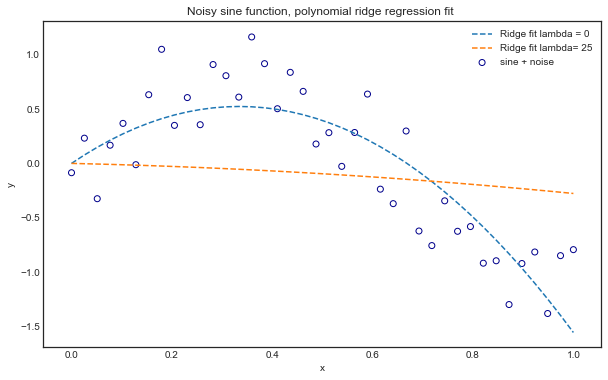

'Coefficients with lambda = 25 are: '

array([[-0.1038542 ],
       [-0.17262311]])

In [25]:
#Creating the dataset (as previously)
x = np.linspace(0,1,40)
noise = 1*np.random.uniform(  size = 40)
y = np.sin(x * 1.5 * np.pi ) 
y_noise = (y + noise).reshape(-1,1)
y_noise = y_noise - y_noise.mean() #Centering the dataset


#Plotting the data
plt.figure(figsize=(10,6))
plt.scatter(x,y_noise, facecolors = 'none', edgecolor = 'darkblue', label = 'sine + noise')
plt.title('Noisy sine function, polynomial ridge regression fit ')
plt.xlabel('x')
plt.ylabel('y')

#Design matrix for polynomial regression of order 2
X = np.vstack((x,x**2)).T

#Calculating closed form regression coefficients with lamda = 0 and 25
theta_calc_0 = closed_form_reg_solution(X,y_noise,lamda = 0)
theta_calc_25 = closed_form_reg_solution(X,y_noise,lamda = 25)

#Plot
plt.plot(x,X@theta_calc_0, '--', label = 'Ridge fit lambda = {}'.format(0))
plt.plot(x,X@theta_calc_25, '--', label = 'Ridge fit lambda= {}'.format(25))
plt.legend()
plt.show()

display('Coefficients with lambda = 25 are: ' ,theta_calc_25)

In [26]:
theta_hist ,J_history =  gradient_descent_reg(X,y,theta,alpha = 0.0005,lamda = 10,num_iters=400)

In [27]:
len(theta_hist)

400

In [28]:
len(J_history)

400

In [29]:
## Extract 1st value from sublist
def Extract_1st(lst): 
    return [item[0] for item in lst] 

In [30]:
## Extract 2nd value from sublist
def Extract_2nd(lst): 
    return [item[1] for item in lst] 

In [31]:
theta_0_hist = list(Extract_1st(theta_hist))
theta_1_hist = list(Extract_2nd(theta_hist))

In [32]:
theta_0 = theta_0_hist 
theta_1 = theta_1_hist

In [33]:
X

array([[0.00000000e+00, 0.00000000e+00],
       [2.56410256e-02, 6.57462196e-04],
       [5.12820513e-02, 2.62984878e-03],
       [7.69230769e-02, 5.91715976e-03],
       [1.02564103e-01, 1.05193951e-02],
       [1.28205128e-01, 1.64365549e-02],
       [1.53846154e-01, 2.36686391e-02],
       [1.79487179e-01, 3.22156476e-02],
       [2.05128205e-01, 4.20775805e-02],
       [2.30769231e-01, 5.32544379e-02],
       [2.56410256e-01, 6.57462196e-02],
       [2.82051282e-01, 7.95529257e-02],
       [3.07692308e-01, 9.46745562e-02],
       [3.33333333e-01, 1.11111111e-01],
       [3.58974359e-01, 1.28862590e-01],
       [3.84615385e-01, 1.47928994e-01],
       [4.10256410e-01, 1.68310322e-01],
       [4.35897436e-01, 1.90006575e-01],
       [4.61538462e-01, 2.13017751e-01],
       [4.87179487e-01, 2.37343853e-01],
       [5.12820513e-01, 2.62984878e-01],
       [5.38461538e-01, 2.89940828e-01],
       [5.64102564e-01, 3.18211703e-01],
       [5.89743590e-01, 3.47797502e-01],
       [6.153846

In [34]:
len(theta_0_hist)

400

In [35]:
len(theta_1_hist)

400

In [36]:
X.shape

(40, 2)

In [37]:
type(X)

numpy.ndarray

In [38]:
y.shape

(40,)

In [39]:
type(y)

numpy.ndarray

#### Generating the data for the contour and surface plots

In [40]:
l = 25 #Complexity hyperparameter lambda = 25

#Setup of meshgrid of theta values
T1, T2 = np.meshgrid(np.linspace(-5,5,400),np.linspace(-6,6,400))

#Computing the cost function for each theta combination
zs = np.array(  [costFunctionReg(X, y_noise.reshape(-1,1),np.array([t1,t2]).reshape(-1,1),l) 
                     for t1, t2 in zip(np.ravel(T1), np.ravel(T2)) ] )
#Reshaping the cost values    
Z = zs.reshape(T1.shape)

#### Animation of the contour plot with gradient descent

Animation size has reached 21109187 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


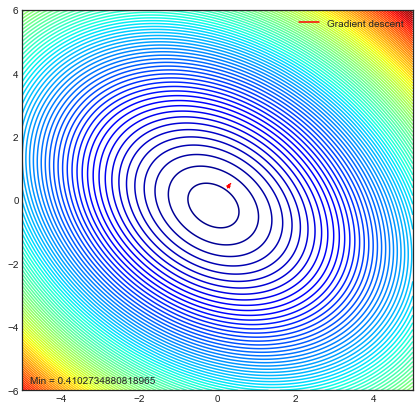

In [41]:
#Plot the contour
J_history_reg = J_history  ## took because no where it is mentioned in blog 
fig1, ax1 = plt.subplots(figsize = (7,7))
ax1.contour(T1, T2, Z, 100, cmap = 'jet')


# Create animation
line, = ax1.plot([], [], 'r', label = 'Gradient descent', lw = 1.5)
point, = ax1.plot([], [], '*', color = 'red', markersize = 4)
value_display = ax1.text(0.02, 0.02, '', transform=ax1.transAxes)

def init_1():
    line.set_data([], [])
    point.set_data([], [])
    value_display.set_text('')

    return line, point, value_display

def animate_1(i):
    # Animate line
    line.set_data(theta_0[:i], theta_1[:i])
    
    # Animate points
    point.set_data(theta_0[i], theta_1[i])

    # Animate value display
    value_display.set_text('Min = ' + str(J_history_reg[i]))

    return line, point, value_display

ax1.legend(loc = 1)

anim1 = animation.FuncAnimation(fig1, animate_1, init_func=init_1,
                               frames=len(theta_0), interval=100, 
                               repeat_delay=60, blit=True)
#plt.show()
HTML(anim1.to_jshtml())

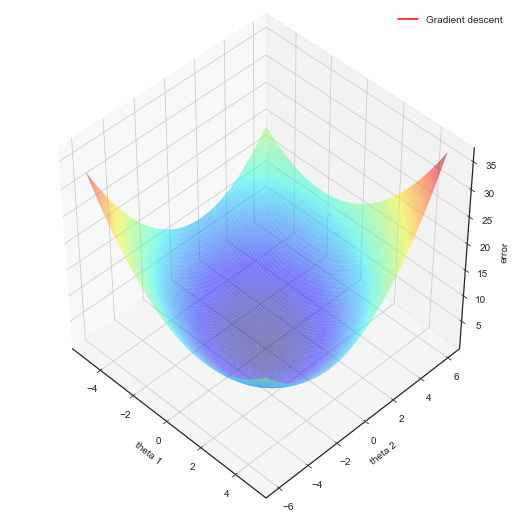

Animation size has reached 21065386 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [42]:
fig2 = plt.figure(figsize = (7,7))
ax2 = Axes3D(fig2)
J_history_reg = J_history  
theta_result_reg = theta_hist
## took because no where it is mentioned in blog
#Surface plot
ax2.plot_surface(T1, T2, Z, rstride = 5, cstride = 5, cmap = 'jet', alpha=0.5)
#ax2.plot(theta_0,theta_1,J_history_reg, marker = '*', color = 'r', alpha = .4, label = 'Gradient descent')

ax2.set_xlabel('theta 1')
ax2.set_ylabel('theta 2')
ax2.set_zlabel('error')
#ax2.set_title('RSS gradient descent: Root at {}'.format(theta_result_reg.ravel()))
ax2.view_init(45, -45)

# Create animation
line, = ax2.plot([], [], [], 'r-', label = 'Gradient descent', lw = 1.5)
point, = ax2.plot([], [], [], '*', color = 'red')
display_value = ax2.text(2., 2., 27.5, '', transform=ax1.transAxes)

def init_2():
    line.set_data([], [])
    line.set_3d_properties([])
    point.set_data([], [])
    point.set_3d_properties([])
    display_value.set_text('')

    return line, point, display_value

def animate_2(i):
    # Animate line
    line.set_data(theta_0[:i], theta_1[:i])
    line.set_3d_properties(J_history[:i])
    
    # Animate points
    point.set_data(theta_0[i], theta_1[i])
    point.set_3d_properties(J_history[i])

    # Animate display value
    display_value.set_text('Min = ' + str(J_history[i]))

    return line, point, display_value

ax2.legend(loc = 1)

anim2 = animation.FuncAnimation(fig2, animate_2, init_func=init_2,
                               frames=len(theta_0), interval=120, 
                               repeat_delay=60, blit=True)

plt.show()
HTML(anim2.to_jshtml())